Μάριος Κερασιώτης | 03117890

-----------

<h2>2<sup>η</sup> ΕΡΓΑΣΤΗΡΙΑΚΗ ΑΣΚΗΣΗ</h2>
<h3>Ανάλυση Κοινωνικής Δομής σε Τεχνητές και Πραγματικές Σύνθετες Τοπολογίες Δικτύων</h3>
<p style=text-align:justify>Στην παρούσα άσκηση θα αναλυθούν τεχνητές και πραγματικές τοπολογίες σύνθετων δικτύων με βάση τις μετρικές που χρησιμοποιήθηκαν στην προηγούμενη άσκηση και κάποιες τεχνικές που έχουν ως στόχο την εύρεση κοινωνικής δομής. Συγκεκριμένα, θα χρησιμοποιηθούν και θα συγκριθούν διάφοροι αλγόριθμοι εντοπισμού κοινοτήτων σε γράφους δικτύων που προκύπτουν από πραγματικά δεδομένα καθώς και στους συνθετικούς γράφους της πρώτης εργαστηριακής άσκησης.</p>

In [51]:
%matplotlib inline

import itertools
import random
import textwrap
import time
import warnings
from datetime import datetime

import joblib
import matplotlib
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import scipy as sp
import seaborn as sns
from sklearn import preprocessing
from sklearn.cluster import SpectralClustering
from tabulate import tabulate
from tqdm.notebook import tqdm

warnings.filterwarnings(action='ignore')
plt.rcParams["figure.figsize"] = (10, 10)
matplotlib.rcParams["figure.dpi"] = 300
sns.set_palette('cubehelix')
sns.set()

Βοηθητικές Συναρτήσεις:

In [10]:
get_values = lambda metric, G: list(metric(G).values())
fancy_tabulate = lambda table, headers: tabulate(
    table, headers, tablefmt="fancy_grid")


def plot_histplot(metric_dict, xlabel, share_axis=True):
    fig, axs = plt.subplots(4, 2, sharex=share_axis)

    for (name, values), ax in zip(metric_dict.items(), fig.axes):
        sns.histplot(values, ax=ax, kde=True)
        ax.axvline(np.mean(values), linestyle='--')
        ax.set_title(name)
        ax.set_xlabel(xlabel)
    plt.tight_layout()

<h3>Α. Μελέτη πραγματικών τοπολογιών</h3>
<p style=text-align:justify>Στο παρόν ερώτημα θα μελετήσετε και θα αποκτήσετε αίσθηση της τοπολογικής δομής πραγματικών δικτύων. Πιο συγκεκριμένα, για τις τοπολογίες που φαίνονται στον <b>πίνακα 1</b>, να βρεθούν και να δειχθούν:</p>
<ol>
    <li>Η κατανομή του βαθμού κόμβου και ο μέσος βαθμός κάθε τοπολογίας.</li>
    <li>Η κατανομή του συντελεστή ομαδοποίησης κόμβου και ο μέσος συντελεστής ομαδοποίησης κάθε τοπολογίας.</li>
    <li>Η κατανομή της κεντρικότητας εγγύτητας και η μέση κεντρικότητα εγγύτητας κάθε τοπολογίας.</li>
</ol>
<p style=text-align:justify>Να συγκριθούν τα αποτελέσματα σε σχέση με αυτά των συνθετικών τοπολογιών. Να χαρακτηρίσετε τον τύπο κάθε μίας από τις πραγματικές τοπολογίες με βάση τους τύπους δικτύων που εξετάστηκαν στην πρώτη εργαστηριακή άσκηση.</p>

<table style=width:100%>
    <caption>Πίνακας <b>1</b>: Πραγματικές τοπολογίες</a></caption>
<tr>
    <th style=text-align:left>Τοπολογία</th>
    <th style=text-align:left>Αρχείο</th>
    <th style=text-align:left>Περιγραφή</th>
</tr>
<tr>
    <td style=text-align:left>American College Football</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/football.zip'>football.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>football.gml</b> contains the network of American football games between Division IA colleges during regular season Fall 2000, as compiled by M. Girvan and M. Newman. The nodes have values that indicate to which conferences they belong.</p>
    </td>
</tr>  
<tr>
    <td style=text-align:left>Game of Thrones - season 5</td>
    <td style=text-align:left><a style=text-decoration:none href='https://networkofthrones.wordpress.com/the-series/season-5/'>GoT</a></td>
    <td style=text-align:left><p style=text-align:justify> The season 5 <b>GoT</b> network represents the interactions between the characters of Game of Thrones in season 5. The season 5 network has 118 nodes (characters) and 394 weighted edges, corresponding to 5,139 interactions. Data can be found here: <a style=text-decoration:none href='https://raw.githubusercontent.com/mathbeveridge/gameofthrones/master/data/got-s5-edges.csv'>GoT_data</a></p>
</tr> 
<tr>
    <td style=text-align:left>email-Eu-core</td>
    <td style=text-align:left><a style=text-decoration:none href='https://snap.stanford.edu/data/email-Eu-core.html'>email-eu-core</a></td>
    <td style=text-align:left><p style=text-align:justify> The network <b>email-Eu-core</b> was generated using email data from a large European research institution. There is an edge (u, v) in the network if person u sent person v at least one email. The e-mails only represent communication between institution members (the core) and the dataset does not contain incoming messages from or outgoing messages to the rest of the world. The dataset also contains "ground-truth" community memberships of the nodes. Each individual belongs to exactly one of 42 departments at the research institute. </p>
</tr> 
    
</table>

<h4>Παραγωγή συνθετικών τοπολογιών</h4> 
<p>Προσοχή! Τα δίκτυα που θα παράξετε θα πρέπει να είναι συνδεδεμένα.</p>

In [11]:
n = 80
d = 4
M = 300
R = 0.25
p = 0.3
k = 4
seedno = 5
random.seed(seedno)

REG = nx.watts_strogatz_graph(n=n, k=k, p=0, seed=seedno)
RGER = nx.gnm_random_graph(n=n, m=M, seed=seedno)
RGG = nx.random_geometric_graph(n=n, radius=R, seed=seedno)
SF = nx.barabasi_albert_graph(n=n, m=d, seed=seedno)
SW = nx.watts_strogatz_graph(n=n, k=k, p=p, seed=seedno)

topologies = {"REG": REG, "RGER": RGER, "RGG": RGG, "SF": SF, "SW": SW}

for name, G in topologies.items():
    assert nx.is_connected(G), "{} should be a connected graph".format(name)

<h4>Εισαγωγή και οπτικοποίηση πραγματικών τοπολογιών.</h4>

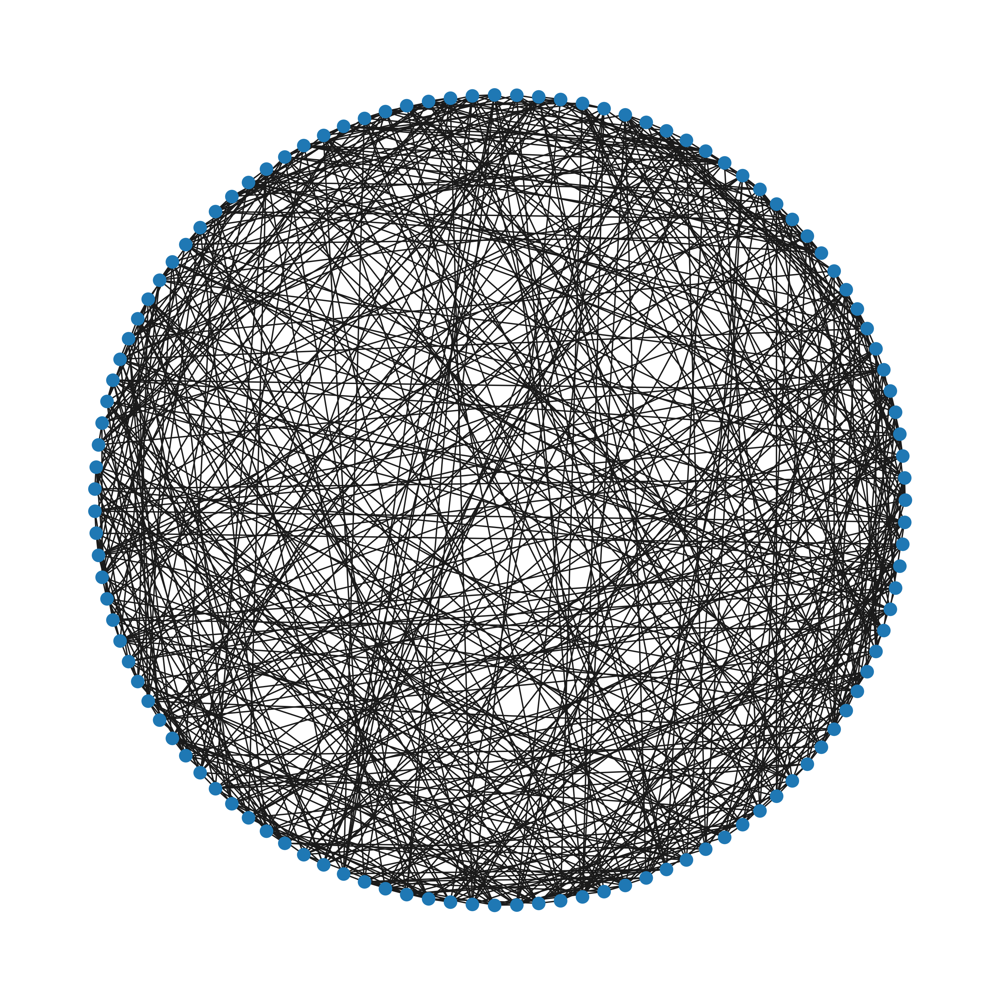

In [12]:
#football network
football = nx.read_gml(r"football.gml")
topologies['Football'] = football
nx.draw_circular(football, node_size=80)

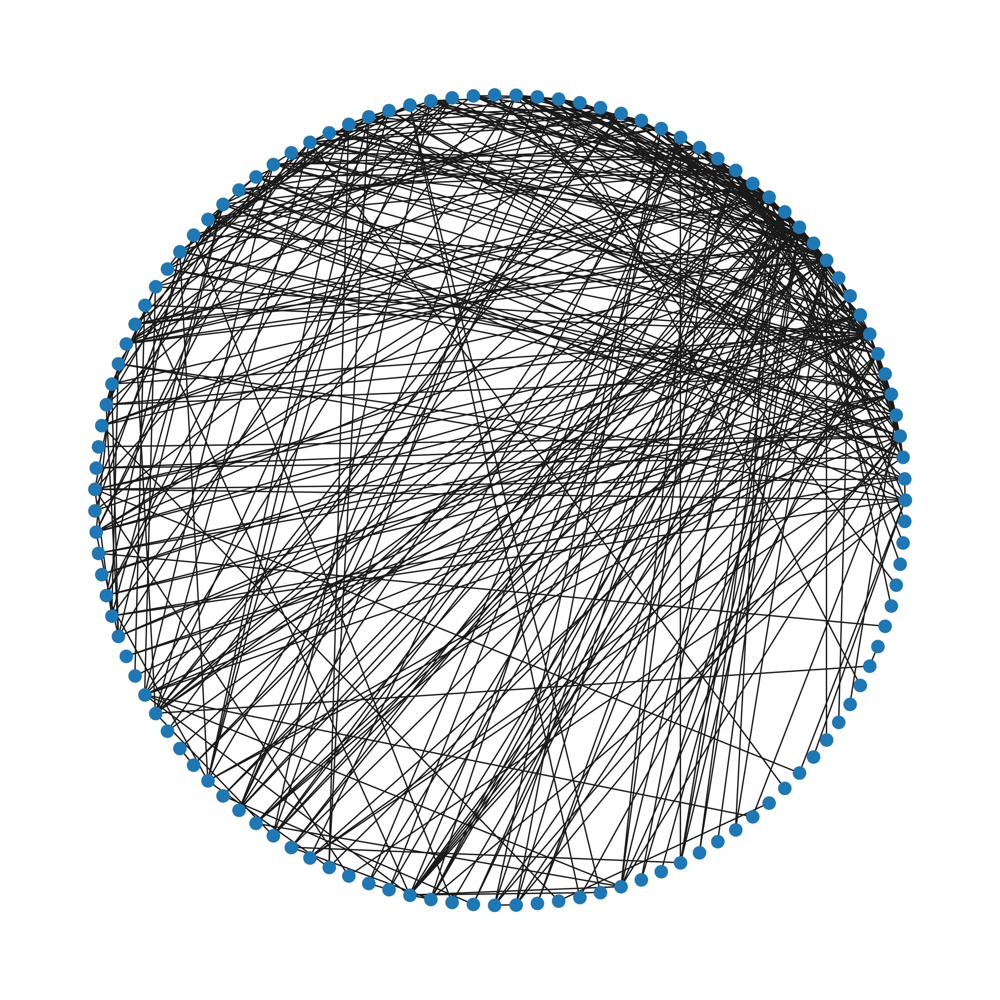

In [13]:
#Game of thrones network
import csv

got = nx.Graph()
with open('got_s5.csv') as csv_file:
    csv_reader = csv.reader(csv_file, delimiter=',')
    line_count = 0
    next(csv_reader)
    for row in csv_reader:
        got.add_edge(row[0], row[1])
        line_count += 1
topologies['Game of Thrones'] = got
nx.draw_circular(got, node_size=80)

#### Προσοχή! Θα μελετήσετε τη μεγαλύτερη συνδεδεμένη συνιστώσα του δικτύου email-Eu-core, αφού πρώτα αφαιρέσετε τα self-loops. Μπορείτε να κάνετε χρήση των συναρτήσεων connected_components, subgraph, remove_edges_from του networkx.

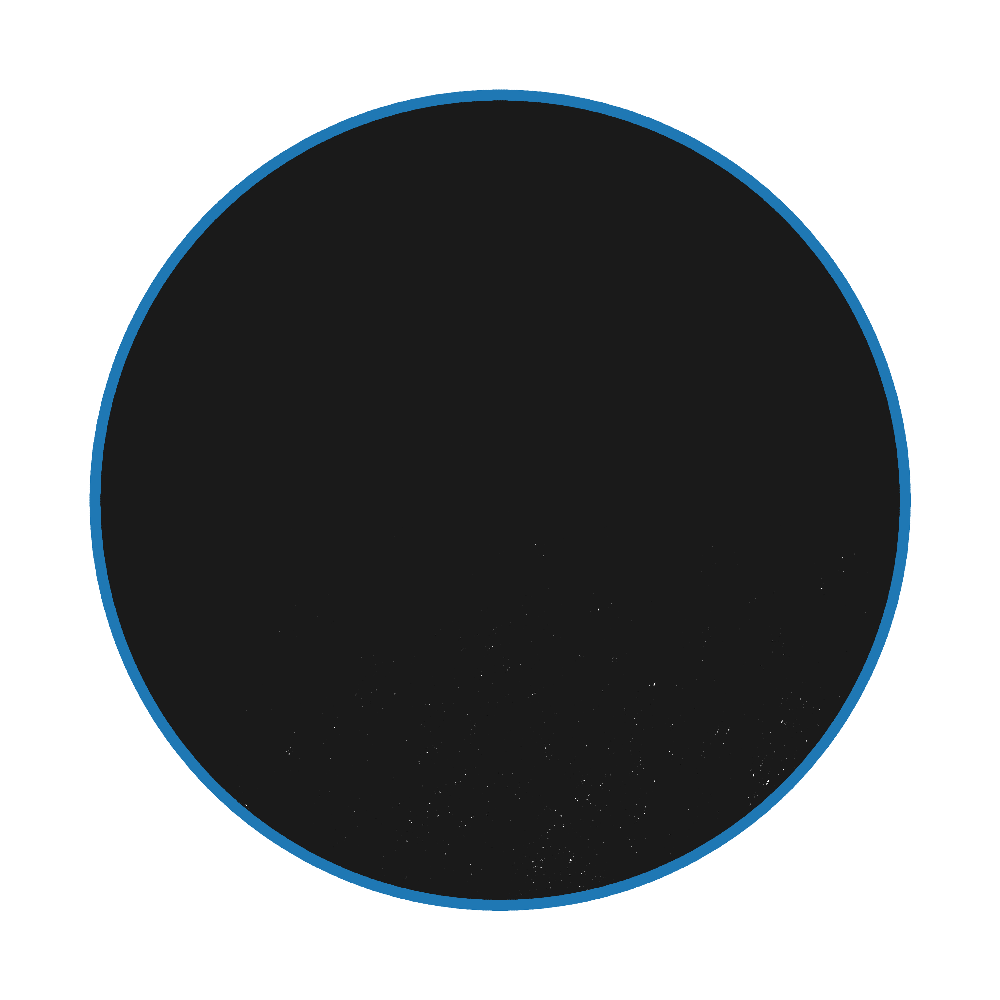

In [14]:
#email-Eu-core network
eu = nx.read_edgelist("email-Eu-core.txt", create_using=nx.Graph())

eu.remove_edges_from(nx.selfloop_edges(eu))
largest_cc = max(nx.connected_components(eu),
                 key=len)  # code from documentation of nx.connected components
eu = eu.subgraph(largest_cc)
topologies['EU email'] = eu
nx.draw_circular(eu, node_size=50)

<h4>Μελέτη βαθμού κόμβου για πραγματικές και συνθετικές τοπολογίες.</h4>

In [15]:
def find_degree(G):
    return dict(G.degree())


degrees_of_topologies = {
    name: get_values(find_degree, G) for name, G in topologies.items()
}

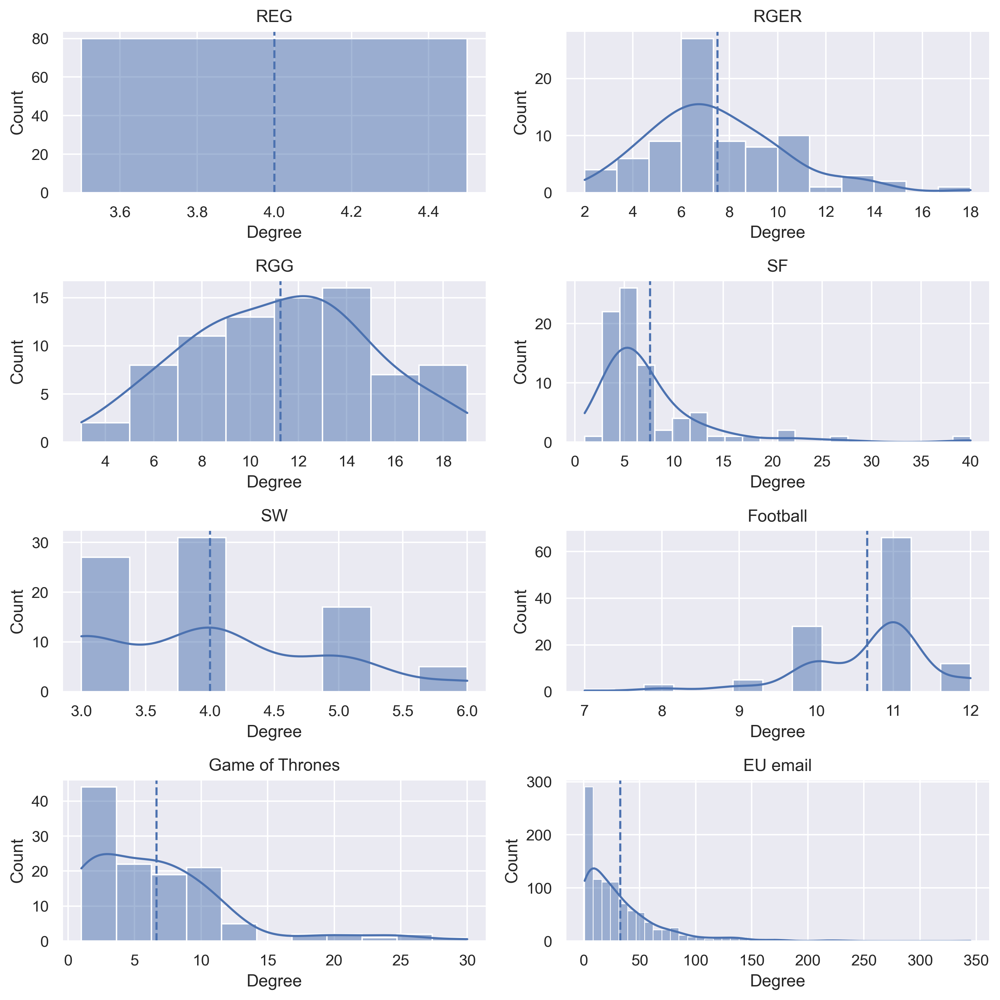

In [16]:
plot_histplot(degrees_of_topologies, "Degree", False)

In [17]:
table = [[name, np.mean(values), np.var(values)]
         for name, values in degrees_of_topologies.items()]
headers = ["Topology", "Mean Degree", "Variance"]
print(fancy_tabulate(table, headers))

╒═════════════════╤═══════════════╤═════════════╕
│ Topology        │   Mean Degree │    Variance │
╞═════════════════╪═══════════════╪═════════════╡
│ REG             │       4       │    0        │
├─────────────────┼───────────────┼─────────────┤
│ RGER            │       7.5     │    8.15     │
├─────────────────┼───────────────┼─────────────┤
│ RGG             │      11.25    │   13.6625   │
├─────────────────┼───────────────┼─────────────┤
│ SF              │       7.6     │   33.39     │
├─────────────────┼───────────────┼─────────────┤
│ SW              │       4       │    0.8      │
├─────────────────┼───────────────┼─────────────┤
│ Football        │      10.6609  │    0.780643 │
├─────────────────┼───────────────┼─────────────┤
│ Game of Thrones │       6.65546 │   31.0494   │
├─────────────────┼───────────────┼─────────────┤
│ EU email        │      32.5842  │ 1370.89     │
╘═════════════════╧═══════════════╧═════════════╛


<font color='blue'>σχολιασμός:</font> Παρατηρούμε πως το football εχει παρόμοια κατανομή με αυτή του RGG, οπως έχει και παραπλησια μέση τιμή. Ως προς το Game of Thrones η κατανανομή του είναι παρόμοια με αυτή της SF, όπως και η μέση τιμή του και η διασπορά του. Τέλος το EU Email ακολουθεί την κατανομή power law, η οποία και αυτή είναι παραπλήσια με την SF.

<h4>Μελέτη συντελεστή ομαδοποίησης για πραγματικές και συνθετικές τοπολογίες</h4>

In [18]:
def cc(G):
    return nx.clustering(G)


cc_of_topologies = {name: get_values(cc, G) for name, G in topologies.items()}

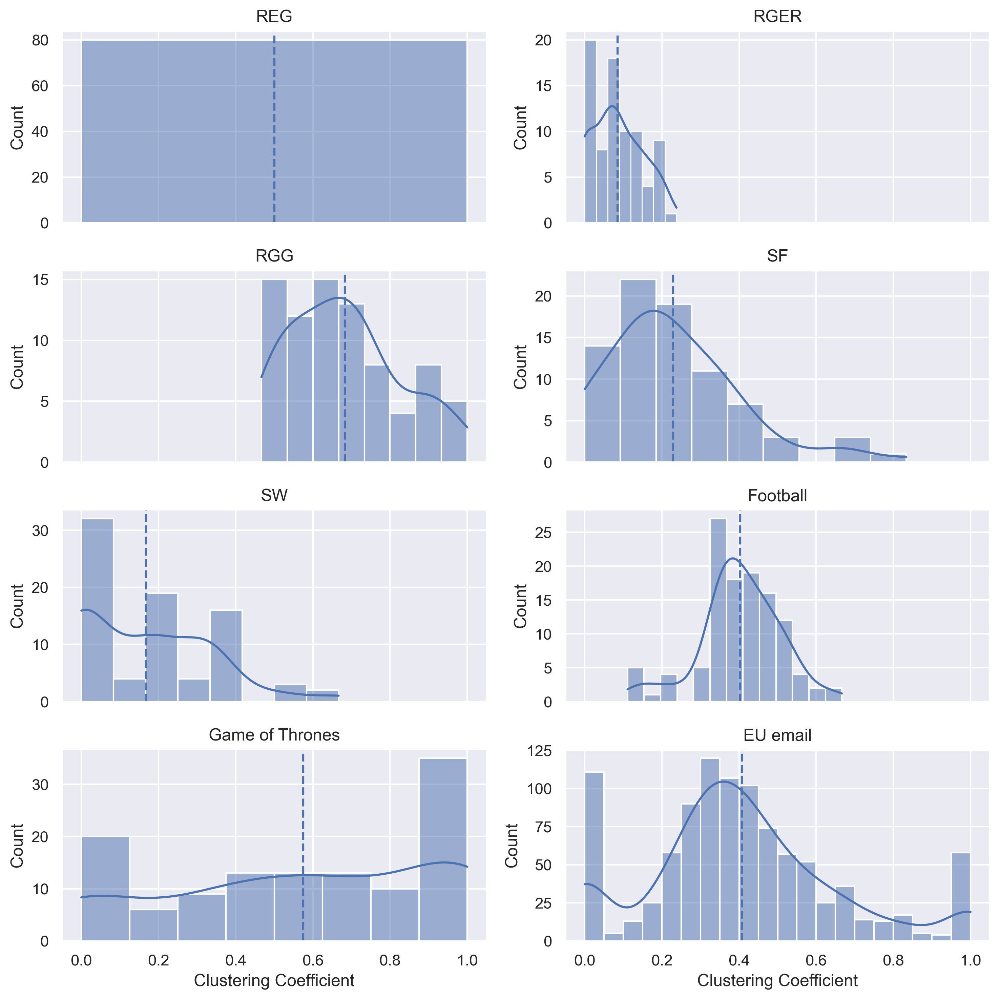

In [19]:
plot_histplot(cc_of_topologies, "Clustering Coefficient")

In [20]:
table = [[name, np.mean(values), np.var(values)]
         for name, values in cc_of_topologies.items()]
headers = ["Topology", "Mean Clustering Coefficient", "Variance"]
print(fancy_tabulate(table, headers))

╒═════════════════╤═══════════════════════════════╤════════════╕
│ Topology        │   Mean Clustering Coefficient │   Variance │
╞═════════════════╪═══════════════════════════════╪════════════╡
│ REG             │                     0.5       │ 0          │
├─────────────────┼───────────────────────────────┼────────────┤
│ RGER            │                     0.0849778 │ 0.00428887 │
├─────────────────┼───────────────────────────────┼────────────┤
│ RGG             │                     0.682579  │ 0.0206504  │
├─────────────────┼───────────────────────────────┼────────────┤
│ SF              │                     0.229228  │ 0.0289289  │
├─────────────────┼───────────────────────────────┼────────────┤
│ SW              │                     0.167083  │ 0.0280693  │
├─────────────────┼───────────────────────────────┼────────────┤
│ Football        │                     0.403216  │ 0.0107675  │
├─────────────────┼───────────────────────────────┼────────────┤
│ Game of Thrones │      

<font color='blue'>σχολιασμός:</font> Παρατηρούμε πως σε αντίθεση με τις προηγούμενες κατανομές, η κατανομή του Football είναι παραπλήσια με αυτήν της RGER. Συνεχίζοντας στο Game of Thrones παρατηρούμε οτι έχει ιδιόρυθμη κατανομή. Παρ' όλα αυτά μοιάζει πιο πολύ με την κατανομή RGG. Τέλος το EU EMAIL έχει κατανομή παραπλήσια του SF.

<h4>Μελέτη κεντρικότητας εγγύτητας για πραγματικές και συνθετικές τοπολογίες </h4>

In [21]:
def find_closeness(G):
    return nx.closeness_centrality(G)


closeness_of_topologies = {
    name: get_values(find_closeness, G) for name, G in topologies.items()
}

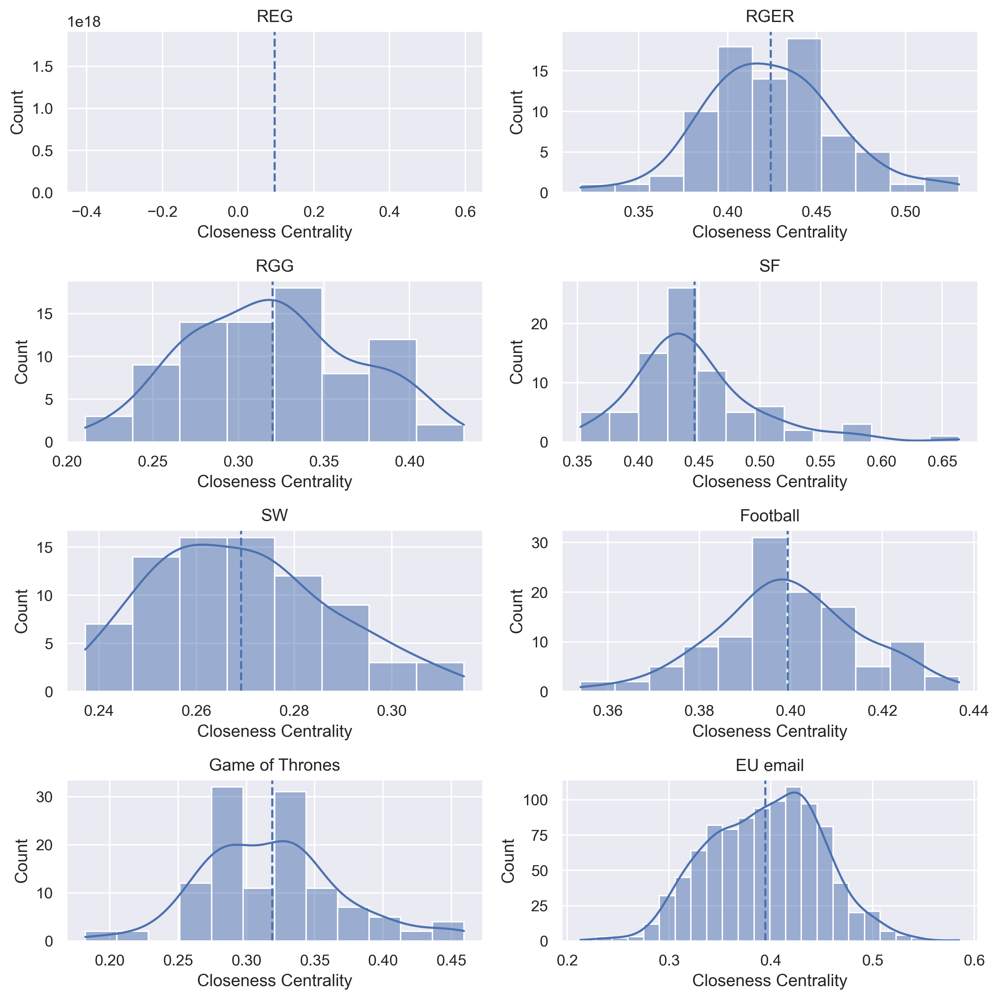

In [22]:
plot_histplot(closeness_of_topologies, "Closeness Centrality", False)

In [23]:
table = [[name, np.mean(values), np.var(values)]
         for name, values in closeness_of_topologies.items()]
headers = ["Topology", "Mean Closeness Centrality", "Variance"]
print(fancy_tabulate(table, headers))

╒═════════════════╤═════════════════════════════╤═════════════╕
│ Topology        │   Mean Closeness Centrality │    Variance │
╞═════════════════╪═════════════════════════════╪═════════════╡
│ REG             │                   0.0963415 │ 1.92593e-34 │
├─────────────────┼─────────────────────────────┼─────────────┤
│ RGER            │                   0.42423   │ 0.00136724  │
├─────────────────┼─────────────────────────────┼─────────────┤
│ RGG             │                   0.320088  │ 0.00235292  │
├─────────────────┼─────────────────────────────┼─────────────┤
│ SF              │                   0.446445  │ 0.00274403  │
├─────────────────┼─────────────────────────────┼─────────────┤
│ SW              │                   0.269143  │ 0.000320118 │
├─────────────────┼─────────────────────────────┼─────────────┤
│ Football        │                   0.399319  │ 0.000246165 │
├─────────────────┼─────────────────────────────┼─────────────┤
│ Game of Thrones │                   0.

<font color='blue'>σχολιασμός:</font> Παρατηρούμε οτι η κατανομή του Football μοιάζει πολύ με αυτήν της SF. Για το GAME OF THRONES παρατηρούμε οτι έχει παραπλήσια κατανομή με αυτή του RGER και το EU MAIL με αυτή το RGG.

<font color='blue'>σχολιασμός:</font> Απο τις παραπάνω μετρικές καταλήγουμε πως EU MAIL SF


<h3>B. Εξοικείωση με τα εργαλεία εντοπισμού κοινοτήτων</h3>
<ol>
<li>Χρησιμοποιώντας τις συναρτήσεις του <b>πίνακα 2</b> για κάθε <u>πραγματικό</u> (<b>πίνακας 1</b>) και <u>συνθετικό</u> (από την <b>άσκηση 1</b>) δίκτυο:</p>
<ol>
    <li>να οπτικοποιηθούν οι κοινότητες που προκύπτουν από την κάθε μέθοδο,</li>
    <li>να γίνουν οι απαραίτητοι σχολιασμοί (π.χ: σύγκριση του αριθμού των κοινοτήτων που υπολογίζει ο κάθε αλγόριθμος).</li>
</ol>
<p>Για την οπτικοποίηση, να επισημανθεί διαφορετικά κάθε κοινότητα, π.χ. με διαφορετικό χρώμα.</p>
<p style=text-align:justify>Στην περίπτωση των συνθετικών δικτύων, να πραγματοποιηθούν συγκρίσεις και μεταξύ των διαφορετικών τύπων τοπολογιών. Για παράδειγμα, στην περίπτωση του τυχαίου γεωμετρικού γράφου, υπάρχει διαισθητικά μία κοινότητα γύρω από κάθε κόμβο που δημιουργείται με βάση τις αποστάσεις του τελευταίου από τους υπόλοιπους κόμβους του δικτύου. Στην περίπτωση των scale-free δικτύων, είναι πιθανό να σχηματίζονται κοινότητες γύρω από τους κόμβους με μεγάλο βαθμό.</p>
<li>Για κάθε αλγόριθμο εντοπισμού κοινοτήτων και για κάθε τοπολογία αξιολογήστε την ποιότητα της διαμέρισης με τις μετρικές performance και modularity (<a style=text-decoration:none href='https://networkx.org/documentation/stable/reference/algorithms/community.html#module-networkx.algorithms.community.quality'>measuring_partitions</a>). Για την μετρική performance, θα χρησιμοποιήσετε την συνάρτηση partition_quality του networkx.</li>
<li>Για την μεγαλύτερη συνδεδεμένη συνιστώσα του email-Eu-core, να συγκρίνετε την ground-truth διαμέριση που δίνεται στο αρχείο Email-Eu-core-department-labels.txt με τις διαμερίσεις που προκύπτουν από τις εξεταζόμενες μεθόδους ως προς το πλήθος των παραγόμενων κοινοτήτων και ως προς τις μετρικές performance και modularity. </li>
<li>Για την παρακολούθηση του χρόνου εκτέλεσης της υλοποίησής σας, μπορείτε να χρησιμοποιήσετε την βιβλιοθήκη <a style=text-decoration:none href='https://tqdm.github.io/'>tqdm</a>. Στο σχολιασμό σας να λάβετε υπόψη το trade-off της ποιότητας της διαμέρισης και του χρόνου εκτέλεσης των εξεταζόμενων αλγορίθμων. </li>
</ol>

<table style=float:left;width:70%>
    <caption>Πίνακας <b>2</b>: Συναρτήσεις εντοπισμού κοινοτήτων</caption>
    <tr>
        <th style=text-align:left> Μέθοδος εντοπισμού κοινοτήτων</th>
        <th style=text-align:left>Συνάρτηση</th>
    </tr>
    <tr>
        <td style=text-align:left>Spectral Clustering</td>
        <td style=text-align:left><a style=text-decoration:none href='http://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html'>SpectralClustering</a></td>
    </tr>
       <tr>
        <td style=text-align:left>Newman-Girvan</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html'>girvan_newman</a></td>
    </tr>
    <tr>
        <td style=text-align:left>Modularity Maximization</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html'>greedy_modularity_communities</a></td>
    </tr>
</table>
    

<p style=text-align:justify>Προτού εφαρμόσετε τις συναρτήσεις εντοπισμού κοινοτήτων μελετήστε προσεκτικά την <b>είσοδο που απαιτούν καθώς και τη μορφή εξόδου που παράγουν.</b></p>

In [24]:
#Χρησιμοποιήστε την συνάρτηση conv2int για να μετατρέψετε τα labels των κόμβων στις πραγματικ΄ές τοπολογίες σε integers
def conv2int(G, start_value):
    nG = nx.convert_node_labels_to_integers(G, first_label=start_value)
    G_mapping = dict(enumerate(G.nodes, 0))
    return nG, G_mapping

In [25]:
topologies['Football'], football_map = conv2int(topologies['Football'], 0)
topologies['Game of Thrones'], got_map = conv2int(topologies['Game of Thrones'],
                                                  0)
topologies['EU email'], eu_email_map = conv2int(topologies['EU email'], 0)

<h4> Ορισμός χρωμάτων για την οπτικοποίηση των κοινοτήτων.</h4>

In [26]:
#insert colors for nodes
from matplotlib import colors as mcolors

colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Newman-Girvan.</h4>
<p>Παράξτε τις διαμερίσεις που προκύπτουν από την μέθοδο Newman-Girvan. Ελέγξτε τις διαμερίσεις που έχουν μέχρι και 50 κοινότητες.</p> 
<p> Επιλέξτε τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

<font color='blue'>σχολιασμός:</font>
Θα δουλέψουμε με δύο μετρικές, τις modularity score και performance score. Η πρώτη, modularity score, εξετάζει το ποσοστό των ακμών που υπάρχουν μέσα σε μια κοινότητα σε σχέση με το ποσοστό των ακμών που θα υπήρχαν εντός της κοινότητας, αν οι ακμές του γράφου είχαν κατανεμηθεί τυχαία, διατηρώντας όμως την κατανομή του βαθμού κόμβου. Η δεύτερη, performance score, προσδιορίζει τον αριθμό των ζευγών κόμβων που έχουν ερμηνευτεί σωστά απο την μέθοδο της διαμέρισης, δηλαδή των αριθμό ζευγών κόμβων που ανήκουν στην ίδια κοινότητα και συνδέονται με ακμή και τον αριθμό ζευγών κόμβων που δεν ανήκουν στην ίδια κοινότητα και δεν συνδέονται με ακμή.



    

In [27]:
# Βοηθητικές συναρτήσεις
metrics = {
    "modularity":
        lambda G, c: nx.algorithms.community.quality.modularity(G, c),
    "performance":
        lambda G, c: nx.algorithms.community.quality.partition_quality(G, c)[1]
}


def get_metrics(topology, metric, limited, time):
    new_start = datetime.now()
    return_data = {
        "topology": topology,
        "max_metric": metric,
    }
    best_community = max(limited,
                         key=lambda c: metrics[metric](topologies[topology], c))
    return_data["communities_count"] = len(best_community)
    return_data['best_partition'] = best_community
    for mname, mmetric in metrics.items():
        return_data[mname] = mmetric(topologies[topology], best_community)
    elapsed_time = datetime.now() - new_start
    return_data['elapsed_time'] = elapsed_time + time
    pbar.update(0.5)
    return return_data


def partitions2string(partitions, size=50):
    string = []
    for part_dict in partitions:
        result = []
        lst = sorted(list(part_dict))
        for k, g in itertools.groupby(enumerate(lst), lambda x: x[0] - x[1]):
            g = list(map(lambda x: x[1], g))
            if len(g) > 1:
                result.append([g[0], g[-1]])
            else:
                result.append([g[0]])

        partition_string = []
        for i in result:
            if len(i) == 1:
                partition_string.append(str(i[0]))
            else:
                partition_string.append('{} - {}'.format(i[0], i[1]))
        string.append("\033[94m>\033[0m " + ", ".join(partition_string))
    return "\n".join([textwrap.fill(di, size) for di in string])


def print_metrics_table(table, metric_name):
    lower_metric_name = metric_name.lower()
    table_best = [[
        res['topology'], res[lower_metric_name],
        res['performance' if lower_metric_name ==
            'modularity' else 'modularity'], res['communities_count'],
        res['elapsed_time'],
        partitions2string(res['best_partition'])
    ] for res in filter(lambda x: x['max_metric'] == lower_metric_name, table)]
    headers = [
        'Topology', 'Max ' + metric_name,
        'Performance' if lower_metric_name == 'modularity' else 'Modularity',
        "Number of \ncommunities", "Elapsed Time", "Partition"
    ]

    print("COMMUNITIES THAT HAVE THE BEST {} METRIC FOR EACH TOPOLOGY".format(
        metric_name.upper()))
    print(fancy_tabulate(table_best, headers))

<font color='blue'>σχολιασμός:</font>
Στα παρακάτω κελιά εισάγω το αρχείο email-Eu-core-department-labels το οποίο περιέχει τους κόμβους και σε ποιά κοινότητα (τμήμα) ανήκει ο κάθε κόμβος. Επειδή έχουμε αλλάξει το όνομα των κόμβων και το έχουμε μετατρέψει σε αριθμό πρέπει να προεπεξεργαστούμε το σύνολο των δεδομένων αυτών και να το φέρουμε σε κατάλληλη μορφή. Δηλαδή πρέπει να κρατήσουμε μόνο τους κόμβους που ανήκουν στην μεγαλύτερη συνιστώσα του γράφου μας και μετά να τους κάνουμε map στους αριθμούς που αντιστοιχούν στους κόμβους μας.

In [28]:
node_mapping = dict((v, k) for k, v in eu_email_map.items())
eu_communities_ground_truth = {}
with open("./email-Eu-core-department-labels.txt", "r") as f:
    for line in f:
        numbers = [x for x in line.split()]
        node = numbers[0]
        community_number = int(numbers[1])
        if (node in node_mapping):
            node = node_mapping[node]
            try:
                eu_communities_ground_truth[community_number].add(node)
            except KeyError:
                eu_communities_ground_truth[community_number] = {node}
eu_communities_ground_truth = list(
    v for v in eu_communities_ground_truth.values())

In [29]:
print('''Ground Truth for EU mail has modularity = {},
                        performance = {}
                        and {} communities'''.format(
    metrics['modularity'](topologies['EU email'], eu_communities_ground_truth),
    metrics['performance'](topologies['EU email'], eu_communities_ground_truth),
    len(eu_communities_ground_truth)))

Ground Truth for EU mail has modularity = 0.28801318862374214,
                        performance = 0.9428136036490563
                        and 42 communities


<font color='blue'>σχολιασμός:</font>
Παρακάτω θα εφαρμόσουμε τον αλγόριθμο Girvan- Newman για να ανιχνεύσουμε τις κοινότητες του γράφου (μέχρι και 50 κοινότητες). Στην συνέχεια για το καλύτερο σετ κοινοτήτων θα επιλέξουμε αυτό με το μεγαλύτερο modularity και ύστερα performance score. Ο Girvan- Newman, συγκεκριμένα, αποτελεί μια μέθοδο hierarchical-centric. Για να ανιχνευσει τις κοινότητες, ο αλγόριθμος, πρώτα αφαιρεί ακμές απο τον αρχικό γράφο και τα συνδεδεμένα τμήματα του παραγόμενου γράφου αποτελούν τις ζητούμενες κοινότητες. Η αφαίρεση των ακμών δεν γίνεται τυχαία, ο αλγόριθμος πρώτα υπολογίζει την betweeness centrallity των ακμών και αφαιρεί τις μεγαλύτερες ακμές. Αυτο το βήμα το επαναλαμβάνει έως ότου κάθε κόμβος αποτελεί μια κοινότητα.

In [30]:
def girvan_newman(topology, k=50):
    start = datetime.now()
    comp = nx.algorithms.community.centrality.girvan_newman(
        topologies[topology])
    limited = list(itertools.takewhile(lambda c: len(c) <= k,
                                       comp))  # from documentation
    pbar.update(1)
    elapsed_time = datetime.now() - start
    metric_results = []
    for metric in metrics.keys():
        metric_results.append(
            get_metrics(topology, metric, limited, elapsed_time))
    return metric_results

In [31]:
iter_product = list(topologies.keys())
girvan_newman_results = []
with tqdm(total=len(iter_product) * 2) as pbar:
    for topology in iter_product:
        girvan_newman_results.extend(girvan_newman(topology, k=50))

  0%|          | 0/16 [00:00<?, ?it/s]

In [32]:
print_metrics_table(girvan_newman_results, "Modularity")

COMMUNITIES THAT HAVE THE BEST MODULARITY METRIC FOR EACH TOPOLOGY
╒═════════════════╤══════════════════╤═══════════════╤═══════════════╤════════════════╤═══════════════════════════════════════════════════╕
│ Topology        │   Max Modularity │   Performance │    Number of  │ Elapsed Time   │ Partition                                         │
│                 │                  │               │   communities │                │                                                   │
╞═════════════════╪══════════════════╪═══════════════╪═══════════════╪════════════════╪═══════════════════════════════════════════════════╡
│ REG             │      0.725       │      0.921519 │             8 │ 0:00:00.456267 │ > 0 - 3, 74 - 79                                  │
│                 │                  │               │               │                │ > 4 - 13                                          │
│                 │                  │               │               │                │ > 14 

In [33]:
print_metrics_table(girvan_newman_results, "Performance")

COMMUNITIES THAT HAVE THE BEST PERFORMANCE METRIC FOR EACH TOPOLOGY
╒═════════════════╤═══════════════════╤══════════════╤═══════════════╤════════════════╤═══════════════════════════════════════════════════╕
│ Topology        │   Max Performance │   Modularity │    Number of  │ Elapsed Time   │ Partition                                         │
│                 │                   │              │   communities │                │                                                   │
╞═════════════════╪═══════════════════╪══════════════╪═══════════════╪════════════════╪═══════════════════════════════════════════════════╡
│ REG             │          0.96962  │  0.6375      │            16 │ 0:00:00.447257 │ > 0 - 3, 79                                       │
│                 │                   │              │               │                │ > 4 - 8                                           │
│                 │                   │              │               │                │ > 9 

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Spectral Clustering. </h4>
Προσοχή! Για την επιλογή της τιμής της παραμέτρου που αφορά στην διάσταση του projection subspace (n_clusters) της συνάρτησης SpectralClustering, θα πρέπει να λάβετε υπόψη το μέγεθος |V| του εκάστοτε δικτύου.
<p>Να εξετάσετε τις διαμερίσεις που προκύπτουν για n_clusters$=2,...,|V|$. Να επιλέξετε για οπτικοποίηση τις διαμερίσεις με το 1) μεγαλύτερο modularity score και 2) performance score για κάθε πραγματικό και συνθετικό δίκτυο.</p>

***Διευκρίνιση: Για τον εντοπισμό των κοινοτήτων με την μέθοδο Spectral Clustering, να εξετάσετε τις διαμερίσεις που προκύπτουν για n-clusters=2,3,..,50.***

<font color='blue'>σχολιασμός:</font>
Στη συνέχεια θα γίνει χρήση του αλγόριθμου Spectral Clustering, ο οποίος αποτελεί μια μέθοδο unsupervised learning. Για να την χρησιμοποιήσουμε πρώτα υπολογίζουμε τον πίνακα γειτνίασης του γράφου. Ακολούθως για k =2 εως 50 η συνάρτηση επιστρέφει τα communitites, τα οποία μετατρέπουμε σε μορφή κατάλληλη για επεξεργασία και επιλέγουμε το καλύτερο ανάλογα με την κάθε μετρική. 

In [34]:
def Spectral_Clustering(topology):

    def labels_to_communities(clustering_labels):
        communities = {i: set() for i in range(cluster_count)}
        for i, c in enumerate(clustering_labels):
            communities[c].add(i)
        return [i for i in communities.values() if len(i) > 0]

    start = datetime.now()
    adjacency_matrix = nx.to_numpy_array(topologies[topology])
    limited = []
    for cluster_count in range(2, 51):
        clustering = SpectralClustering(cluster_count, n_jobs=-1)
        clustering.fit(adjacency_matrix)
        limited.append(labels_to_communities(clustering.labels_))
    pbar.update(1)

    elapsed_time = datetime.now() - start
    metric_results = []
    for metric in metrics.keys():
        metric_results.append(
            get_metrics(topology, metric, limited, elapsed_time))
    return metric_results

In [35]:
iter_product = list(topologies.keys())
spectral_clustering = []
with tqdm(total=len(iter_product) * 2) as pbar:
    for topology in iter_product:
        spectral_clustering.extend(Spectral_Clustering(topology))

  0%|          | 0/16 [00:00<?, ?it/s]

In [36]:
print_metrics_table(spectral_clustering, "Modularity")

COMMUNITIES THAT HAVE THE BEST MODULARITY METRIC FOR EACH TOPOLOGY
╒═════════════════╤══════════════════╤═══════════════╤═══════════════╤════════════════╤════════════════════════════════════════════════════╕
│ Topology        │   Max Modularity │   Performance │    Number of  │ Elapsed Time   │ Partition                                          │
│                 │                  │               │   communities │                │                                                    │
╞═════════════════╪══════════════════╪═══════════════╪═══════════════╪════════════════╪════════════════════════════════════════════════════╡
│ REG             │      0.725313    │     0.904747  │             7 │ 0:00:05.188326 │ > 53 - 65                                          │
│                 │                  │               │               │                │ > 66 - 76                                          │
│                 │                  │               │               │                │

In [37]:
print_metrics_table(spectral_clustering, "Performance")

COMMUNITIES THAT HAVE THE BEST PERFORMANCE METRIC FOR EACH TOPOLOGY
╒═════════════════╤═══════════════════╤══════════════╤═══════════════╤════════════════╤════════════════════════════════════════════════════╕
│ Topology        │   Max Performance │   Modularity │    Number of  │ Elapsed Time   │ Partition                                          │
│                 │                   │              │   communities │                │                                                    │
╞═════════════════╪═══════════════════╪══════════════╪═══════════════╪════════════════╪════════════════════════════════════════════════════╡
│ REG             │         0.972785  │   0.55625    │            21 │ 0:00:05.158407 │ > 5 - 8                                            │
│                 │                   │              │               │                │ > 51 - 55                                          │
│                 │                   │              │               │                

<h4>Εντοπισμός κοινοτήτων σε συνθετικά και πραγματικά δίκτυα με τη μέθοδο Modularity Maximization.</h4>
Για την διαμέριση που θα προκύψει σε κάθε συνθετικό και πραγματικό δίκτυο, να υπολογίσετε το modularity score και το performance score.

<font color='blue'>σχολιασμός:</font>
Τέλος χρησιμοποιούμε τον αλγόριθμο greedy modularity. Η συγκεκριμένη συνάρτηση χρησιμοποιεί τον αλγόριθμο Clauset-Newman-Moore Modularity Maximization όποιος θεωρεί ένα κόμβο ως μια κοινότητα και ενώνει τα ζεύγη των κοινότήτων με σκοπό να αυξήσει το modularity

In [38]:
def greedy_modularity_communities(topology):
    start = datetime.now()
    communities = nx.algorithms.community.modularity_max.greedy_modularity_communities(
        topologies[topology])
    return_data = {
        "topology": topology,
        "best_partition": communities,
        "communities_count": len(communities)
    }
    for mname, mmetric in metrics.items():
        return_data[mname] = mmetric(topologies[topology], communities)
    return_data["elapsed_time"] = datetime.now() - start
    pbar.update(1)
    return return_data

In [39]:
iter_product = list(topologies.keys())
greedy_modularity = []
with tqdm(total=len(iter_product)) as pbar:
    for topology in iter_product:
        greedy_modularity.append(greedy_modularity_communities(topology))

  0%|          | 0/8 [00:00<?, ?it/s]

In [40]:
table_best = [[
    res['topology'], res['modularity'], res['performance'],
    res['communities_count'], res['elapsed_time'],
    partitions2string(res['best_partition'])
] for res in greedy_modularity]
headers = [
    'Topology', 'Max Modularity', "Performance", "Number of Communities",
    "Elapsed Time", "Partition"
]

print(fancy_tabulate(table_best, headers))

╒═════════════════╤══════════════════╤═══════════════╤═════════════════════════╤════════════════╤════════════════════════════════════════════════════╕
│ Topology        │   Max Modularity │   Performance │   Number of Communities │ Elapsed Time   │ Partition                                          │
╞═════════════════╪══════════════════╪═══════════════╪═════════════════════════╪════════════════╪════════════════════════════════════════════════════╡
│ REG             │         0.673125 │      0.800633 │                       4 │ 0:00:00.022972 │ > 0 - 20                                           │
│                 │                  │               │                         │                │ > 21 - 41                                          │
│                 │                  │               │                         │                │ > 42 - 62                                          │
│                 │                  │               │                         │              

#### Βοηθητικες συναρτήσεις για την οπτικοποίηση κοινοτήτων

In [41]:
def get_community(some_list, topology, max_metric=None):
    if max_metric:
        return list(
            filter(
                lambda x: x['topology'] == topology and x['max_metric'] ==
                max_metric, girvan_newman_results))[0]['best_partition']
    else:
        return list(
            filter(lambda x: x['topology'] == topology,
                   girvan_newman_results))[0]['best_partition']


communities = {}
communities["EU email ground truth"] = eu_communities_ground_truth

for metric in metrics.keys():
    communities["girvan_newman_" + metric] = {
        k: get_community(girvan_newman_results, k, metric)
        for k in topologies.keys()
    }
    communities["spectral_clustering_" + metric] = {
        k: get_community(spectral_clustering, k, metric)
        for k in topologies.keys()
    }
communities["greedy_modularity"] = {
    k: get_community(greedy_modularity, k) for k in topologies.keys()
}

In [107]:
def visualize_communities(G, communities, title, axis):
    degrees = dict(G.degree)

    degree_values = list(degrees.values())
    scaled_degree_values = list(
        preprocessing.minmax_scale(degree_values, (10, 200)))

    node_position = nx.spring_layout(G)
    for i, s in enumerate(communities):
        c_scaled_degree_values = [scaled_degree_values[i] for i in list(s)]
        nx.draw_networkx_nodes(G,
                               node_position,
                               nodelist=list(s),
                               node_size=c_scaled_degree_values,
                               node_color=colors[i],
                               ax=axis)
    nx.draw_networkx_edges(G, node_position, alpha=0.3, ax=axis)

    axis.set_title(title)


def visualize_multiple(title, topology, show_ground_truth=False):
    fig, axes = plt.subplots(nrows=3, ncols=2)
    fig.suptitle(title)

    visualize_communities(topologies[topology],
                          communities['girvan_newman_modularity'][topology],
                          "Girvan- Newman Modularity", axes[0][0])

    visualize_communities(topologies[topology],
                          communities['girvan_newman_performance'][topology],
                          "Girvan- Newman Performance", axes[0][1])

    visualize_communities(
        topologies[topology],
        communities['spectral_clustering_modularity'][topology],
        "Spectral Clustering Modularity", axes[1][0])

    visualize_communities(
        topologies[topology],
        communities['spectral_clustering_performance'][topology],
        "Spectral Clustering Performance", axes[1][1])

    visualize_communities(topologies[topology],
                          communities['greedy_modularity'][topology],
                          "Greedy Modularity", axes[2][0])

    if (show_ground_truth):
        visualize_communities(topologies['EU email'],
                              communities['EU email ground truth'],
                              "Ground Truth", axes[2][1])
    else:
        axes[2][1].set_visible(False)

    fig.tight_layout()

#### Οπτικοποίηση κοινοτήτων American College Football

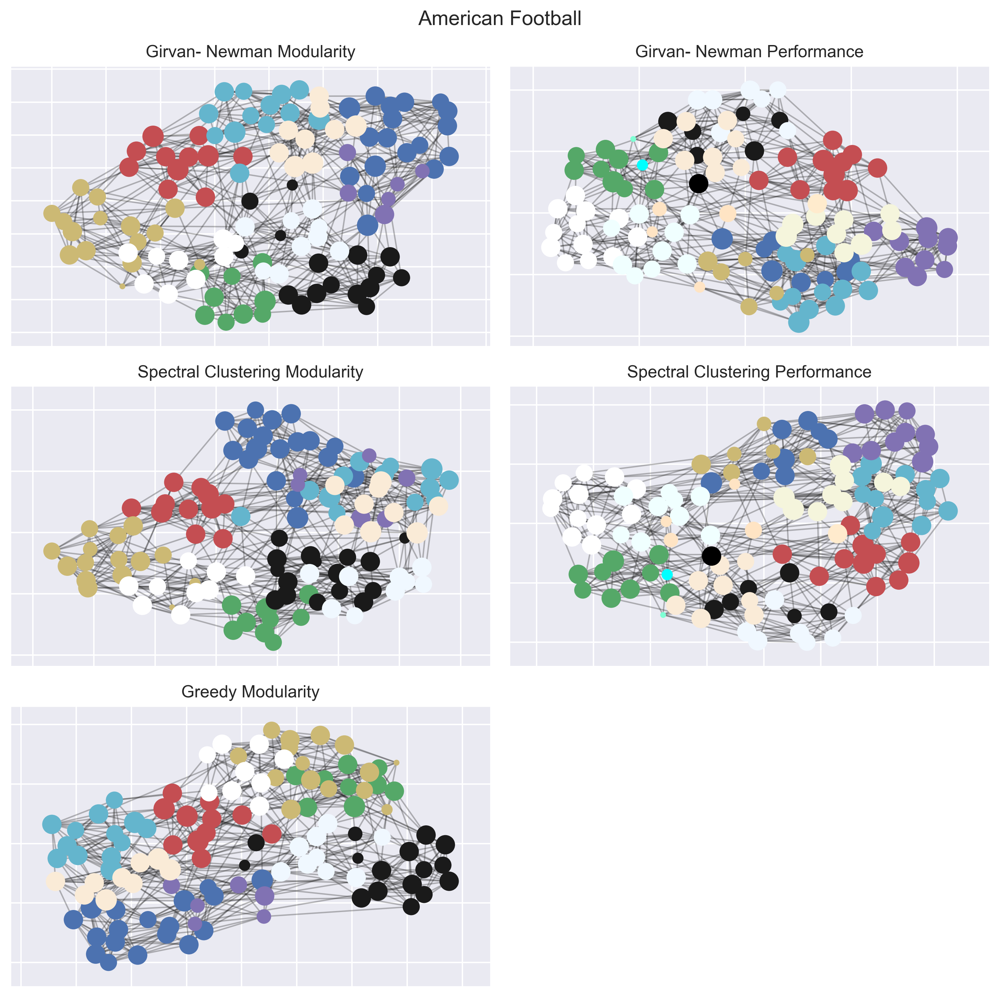

In [108]:
visualize_multiple('American Football', 'Football')

<font color='blue'>σχολιασμός:</font> Απο τους πίνακες και τα διαγράμματα παραπάνω πρατηρούμε πως εκτός απο την greedy modularity που παράγει 6 κοινότητες, οι άλλες συναρτήσεις παράγουν 10 κοινότητες αν έχουν το μέγιστο modularity και 17 και 14 κοινότητες για τις συναρτήσεις girvan newman και spectral clustering αντίστοιχα, αν αυτές έχουν μέγιστο performance. Ακόμα τα modularity κυμαίνονται από 0.55 έως 0.6 και τα performance από 0.93 έως 0.94 εκτός του greedy modularity που έχει performance 0.86. Ως προς τους χρόνους εκτέλεσης παρατηρούμε πως οι συναρτήσεις girvan newman και spectral clustering παίρνουν 7 δευτερόλεπτα ενώ η greedy modularity μόνο 0.5μs. Τέλος ακόμα και απο την οπτικοποίηση μπορούμε να δούμε πως οι γράφοι μπορούν να χωριστούν σε κοινότητες αρκετά εύκολα.

#### Οπτικοποίηση κοινοτήτων Game of Thrones

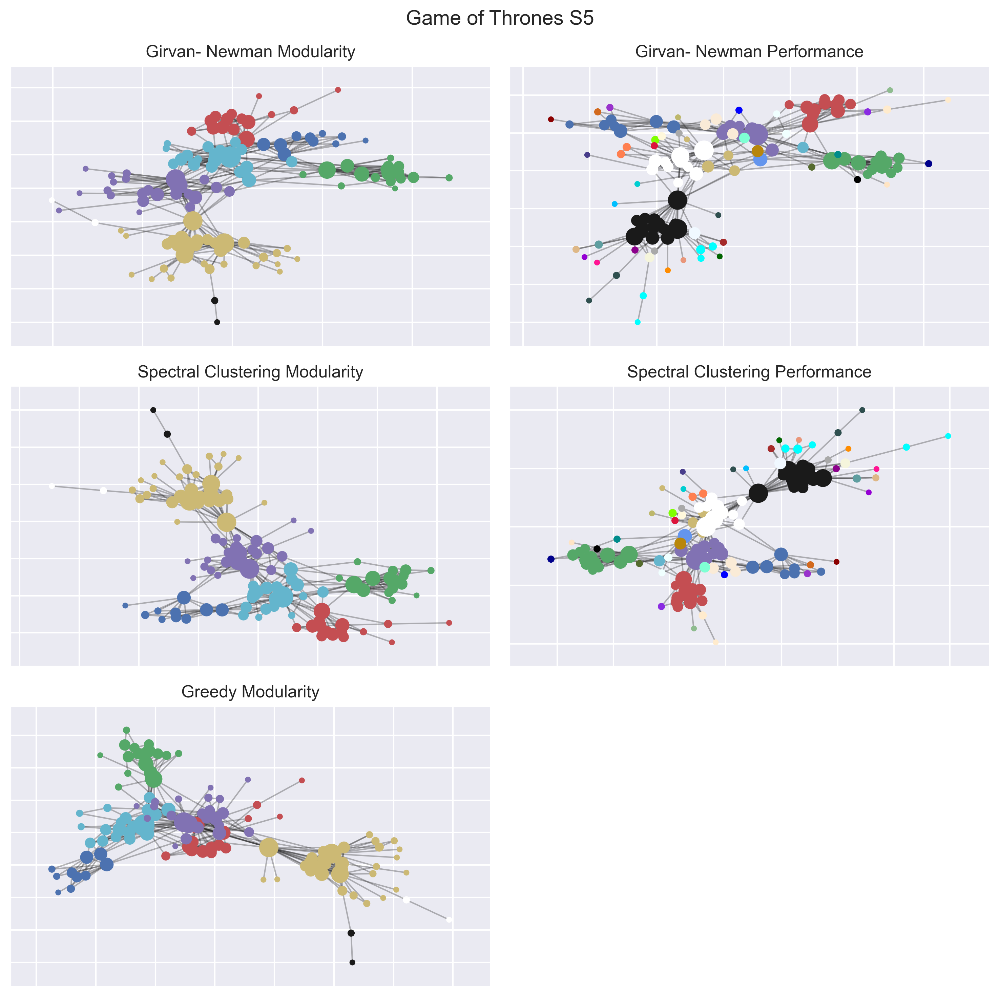

In [109]:
visualize_multiple('Game of Thrones S5', 'Game of Thrones')

<font color='blue'>σχολιασμός:</font> Απο τους πίνακες και τα διαγράμματα παραπάνω πρατηρούμε πως έχουμε μεγάλη διακύμναση στης κοινότητες και τις μετρικές. Με την girvan newman έχουμε 8 κοινότητες για max modularity 0.66 και performance 0,87 ενώ για max performance 0.94 εχουμε 50 κοινότητες και modularity 0.48. Με χρήση της spectral clustering πετυχαίνουμε max modularity 0.42 σε 4 κοινότητες και 0.49 performance ενώ για maz performance 0,74 πετυχαίνουμε modularity 0.043 με 38 κοινότητες. Τέλος η greedy modularity μας δίνει 0.66 max modularity και 0.82 performance με 5 κοινότητες. Ως προς τους χρόνους η girvan newman παίρνει 2s, η spectral clustering 6s και η greedy modularity μόλις 3μs. Έτσι καταλήγουμε πως η καλύτερη επιλογή είναι να επιλέξουμε μια απο τις girvan newman και greedy modularity αφού αυτές βγάζουν τις καλύτερες μετρικές στον λιγότερο χρόνο.

#### Οπτικοποίηση κοινοτήτων email-Eu-core (να οπτικοποιηθεί και η ground-truth διαμέριση)

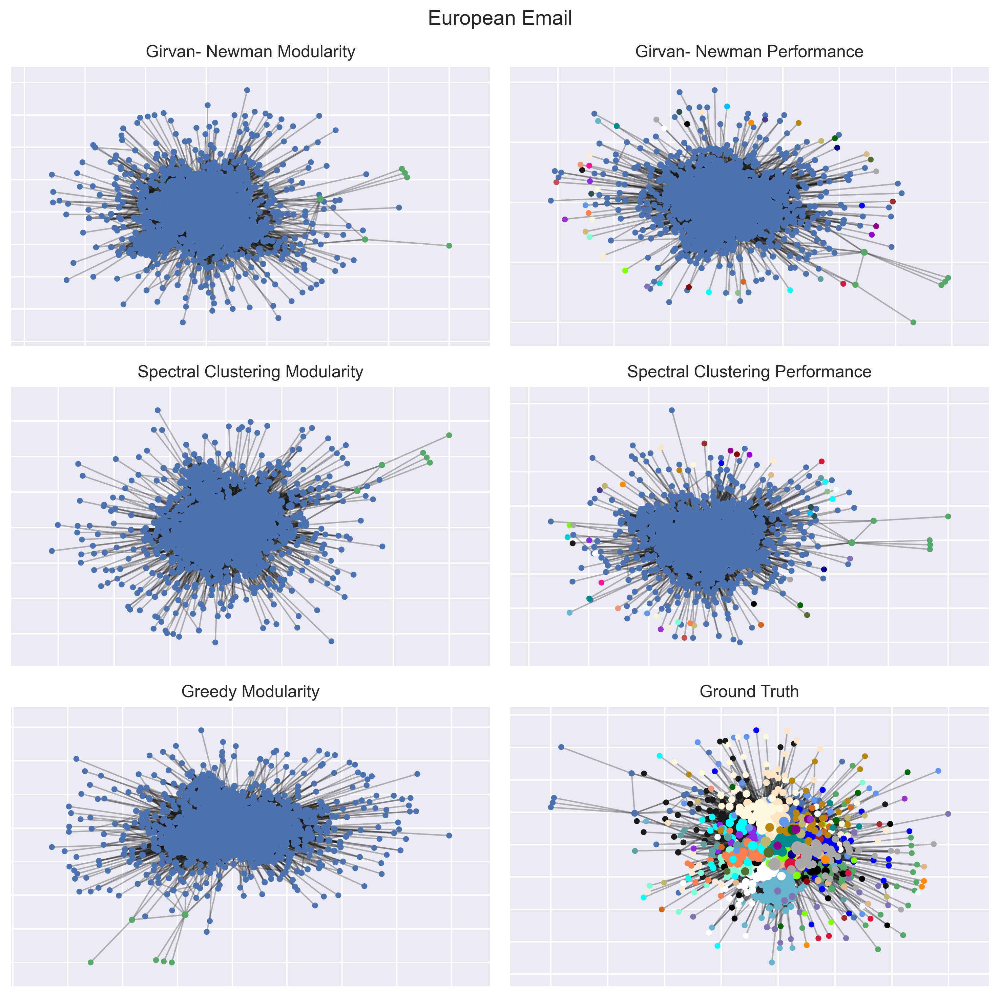

In [110]:
visualize_multiple('European Email', 'EU email', show_ground_truth=True)

<font color='blue'>σχολιασμός:</font> Αρχικά για τον γράφο EU Email εισάγουμε παίρνουμε τις μετρικές απο το ποιοί κόμβοι- υπάλληλοι βρίσκονται σε ποιά τμήματα. Αρχικά για την συνάρτηση girvan newman πετυχαίνουμε max modularity 0.0006 και performance 0.045 με 2 κοινότητες. Για max performance 0.13 εχουμε modularity 0.0006 με 50 κοινότητες. Συνεχίζοντας με την συνάρτηση spectral clustering πετυχαίνουμε max modularity -0.0002 και performance 0.033 με 2 κοινότητες, ενώ με max performance 0.08 έχουμε modularity -0.003 και 29 κοινότητες. Τέλος με την χρήση του greedy modularity καταφέρνουμε 0.34 max modularity και 0.7 performance και 8 κοινότητες. Παρατηρούμε δηλαδή πως η συνάρτηση που βρίσκει τα καλύτερα αποτελέσματα είναι η greedy modularity που παίρνει και το λιγότερο χρόνο αφού παίρνει μόνο 4 δευτερόλεπτα σε αντίθεση με τα 10 και 1 λεπτά των girvan newman και spectral clustering αντίστοιχα. Παρατηρούμε απο τα διαγράμματα πως η ground truth κοινότητα είναι πολύ διαφορετική από τα υπόλοιπα διαγράμματα με τα πιο κοινά να είναι αυτά του Girvan Newman με max performance και spectral clustering με max performance.

#### Οπτικοποίηση κοινοτήτων REG

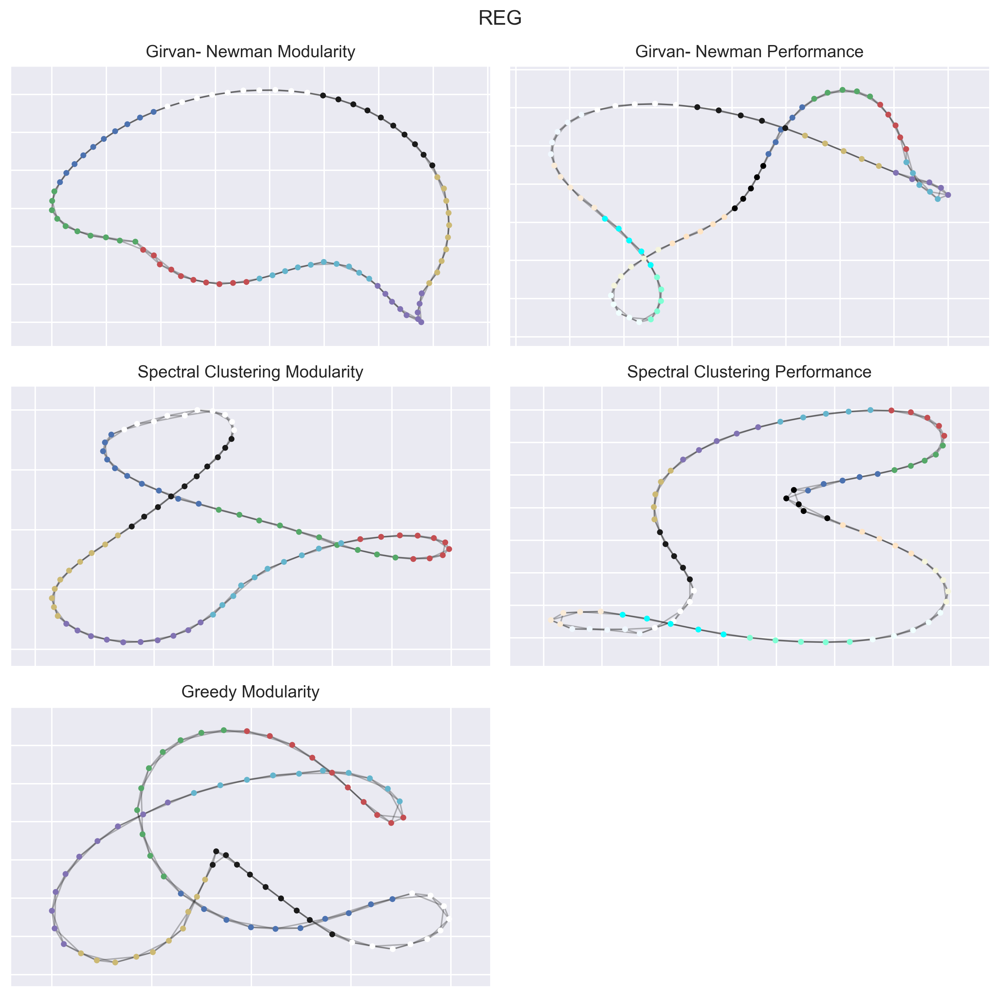

In [111]:
visualize_multiple('REG', 'REG')

<font color='blue'>σχολιασμός:</font> Για το REG λόγω της καθορισμένης διάταξης του είναι πιο εύκολη η δημιουργία και διάκριση κοινοτήτων καθώς οι αποστάσεις μεταξύ των κόμβων είναι καθορισμένες από τη γεωμετρία του γραφήματος. Παρατηρούμε σχεδόν άριστo performance από όλες τις μεθόδους με μικρή πτώση στην άπληστη μέθοδο. Οι μέθοδοι παράγουν παρόμοια μεγέθη κοινοτήτων με την μικρότερη να είναι 4. Οι κοινότητες έχουν σχεδόν βέλτιστο αποτέλεσμα καθώς η διάκριση του είναι εύκολη στον χώρο έτσι όπως έχουν τοποθετηθεί.

#### Οπτικοποίηση κοινοτήτων RGER

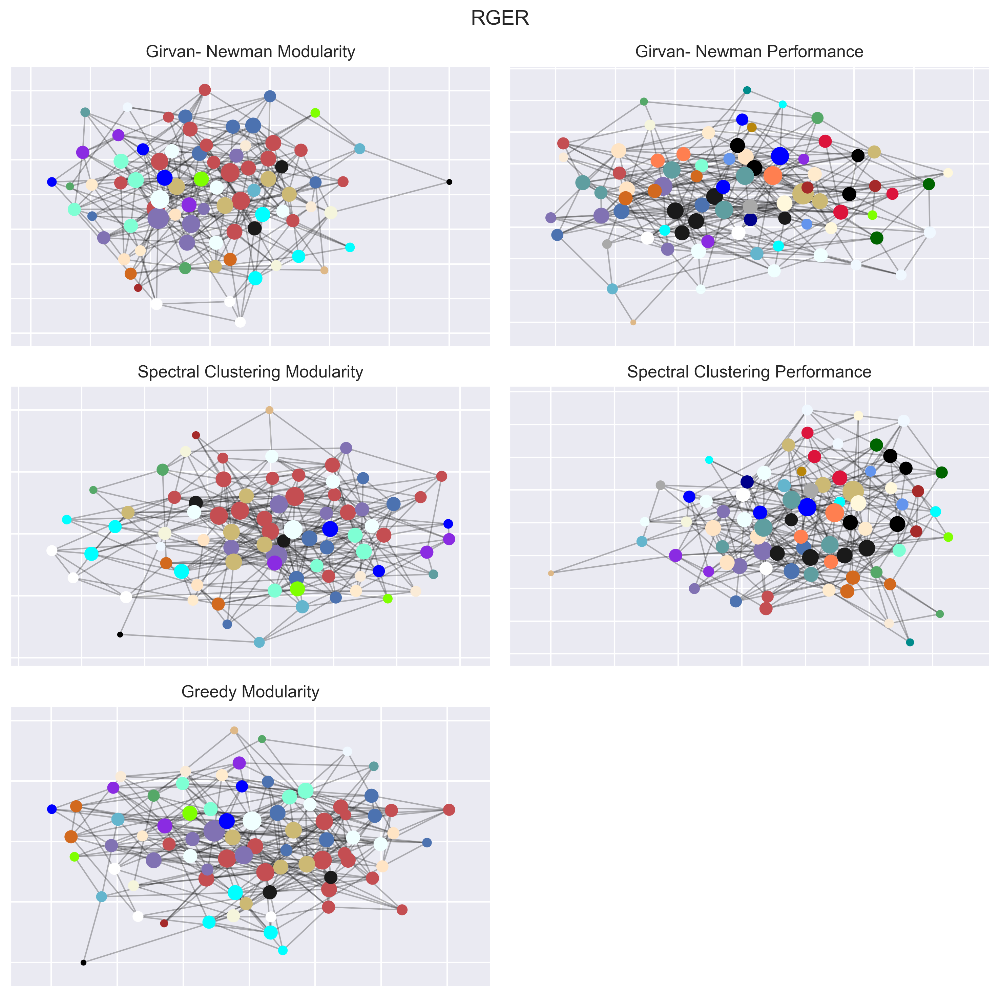

In [112]:
visualize_multiple('RGER', 'RGER')

<font color='blue'>σχολιασμός:</font> Παρατηρούμε πως για όλες τις συναρτήσεις το modularity βγαίνει μικρό. Αντίθετα όμως το performance στην girvan newman βγαίνει 0.89 και 0.92 για max modularity και max performance αντίστοιχα ενώ στην spectral 0.64 και 0.8. Τέλος στην greedy modularity βγαίνει 0.75. Ως προς τις κοινότητες η greedy παράγει 24 και 34 για max modularity και max performance αντίστοιχα ενώ η spectral clustering 17 και 50. H greedy δίνει μόνο 4. Τα παραπάνω αποτελέσματα συμφωνούν με την θεωρία και όσα αναμέναμε. Δηλαδή για τυχαίο γράφημα που η σύνδεση των κόμβων του γίνεται τυχαία η πιθανότητα να βρούμε κοινότητες είναι αρκετά μικρή.

#### Οπτικοποίηση κοινοτήτων RGG

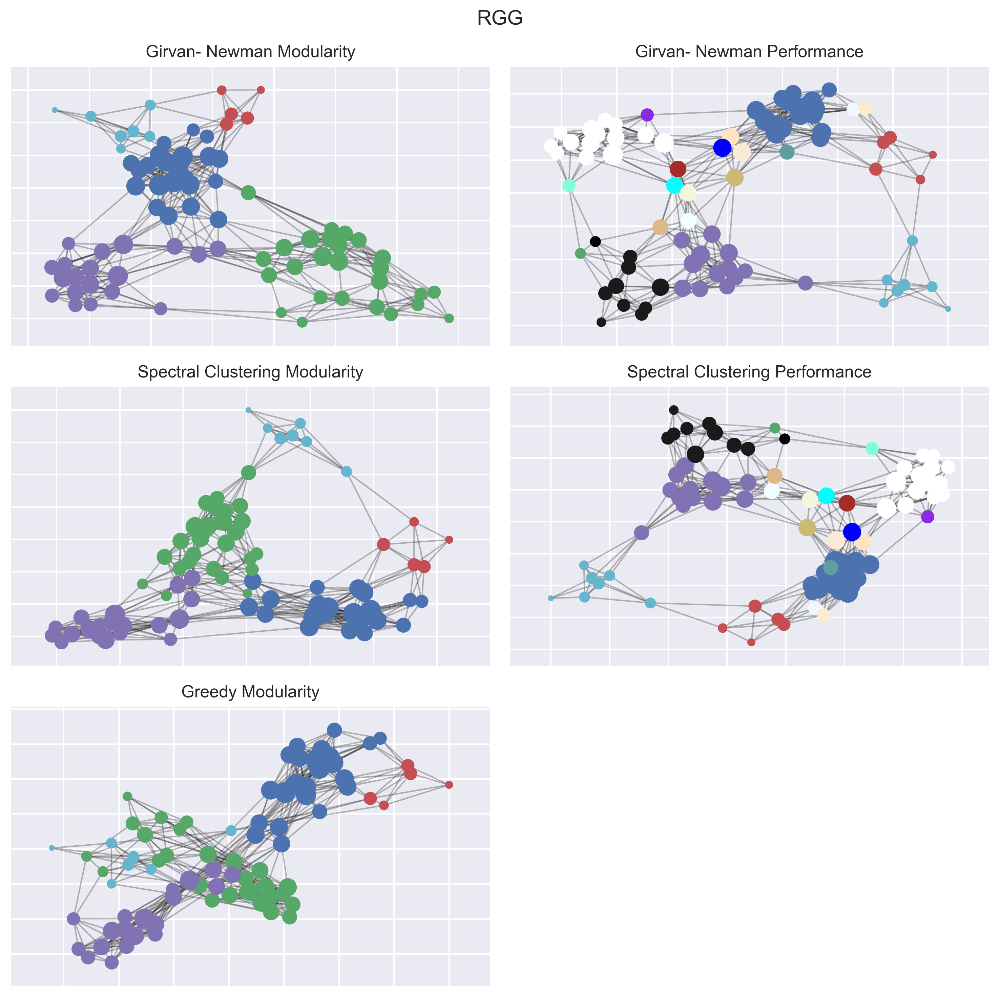

In [113]:
visualize_multiple('RGG', 'RGG')

<font color='blue'>σχολιασμός:</font> To RGG πως το μέγιστο modularity του ανέρχεται στο 0.59 και το performance του κυμαίνεται απο 0.82 στο 0.92. Οι κοινότητες ανάλογα τον αλγόριθμο είναι 5 και 22 για girvan newman σε max modularity και max performance αντίστοιχα. Ενώ 4 και 12 για τον spectral clustering και τέλος 4 για τον greedy modularity. Στα διαγράμματα οι κοινότητες είναι ευδιάκριτες. Γενικά απο τα χαρακτηριστικά του γράφου (ο κόμβος συνδέεται με κόμβος μέσα σε μια ακτίνα) περιμένουμε να δημιουργούνται κοινότητες γύρω απο ένα κόμβο.

#### Οπτικοποίηση κοινοτήτων SW

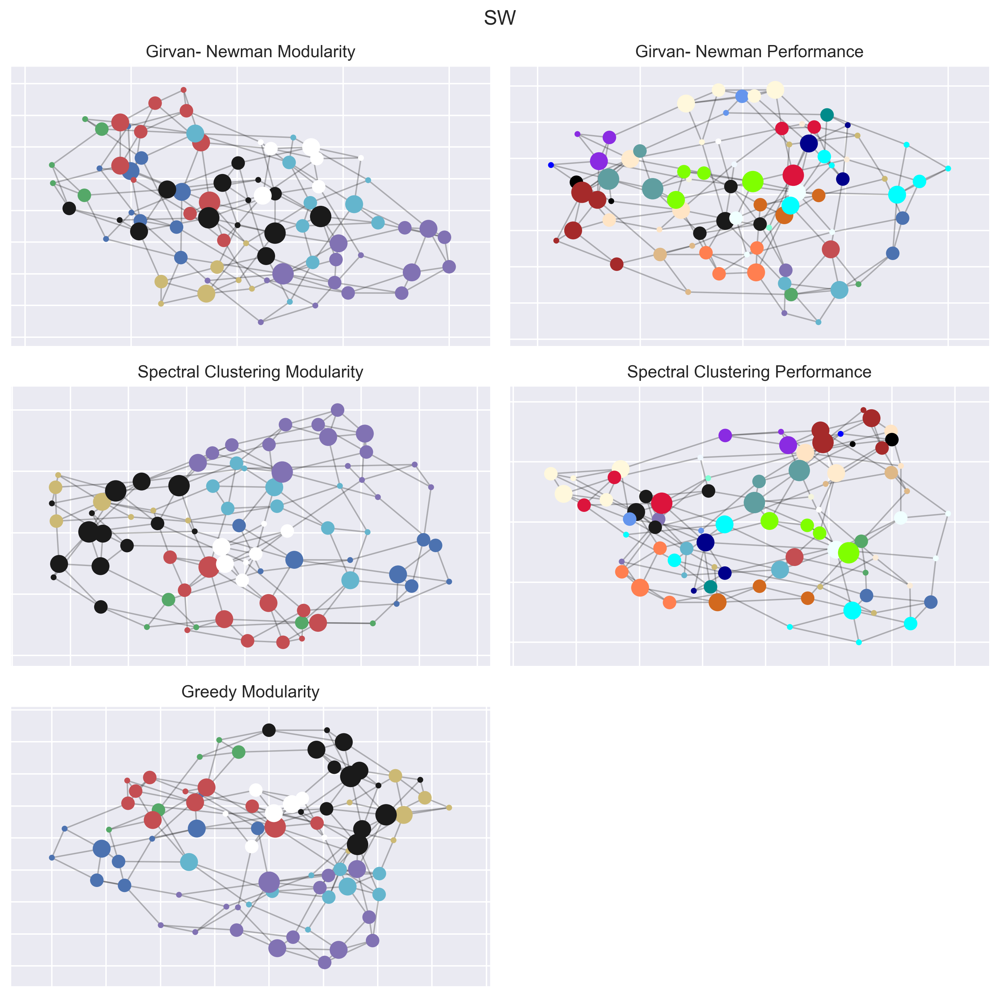

In [114]:
visualize_multiple('SW', 'SW')

<font color='blue'>σχολιασμός:</font> 
Στα SW γραφήματα αναμένουμε να σχηματιστούν κοινότητες γύρω από τους κόμβους με μεγάλο βαθμό. Αν και παρατηρούμε διακυμάνσεις στο modularity μεταξύ των διαφορετικών μεθόδων προσέγγισης (με την σημαντικότερη να είναι η spectral clustering για max performance) οπτικά έχουμε στις περισσότερες περιπτώσεις θετικά αποτελέσματα. Επίσης και πάλι παρατηρούμε ότι εκεί που έχουμε περιορισμένη τιμή modularity οι κοινότητες είναι πιο κοντά μεταξύ τους κάνοντας δυσκολότερη την διάκριση χωρίς την χρήση χρωμάτων.

#### Οπτικοποίηση κοινοτήτων SF

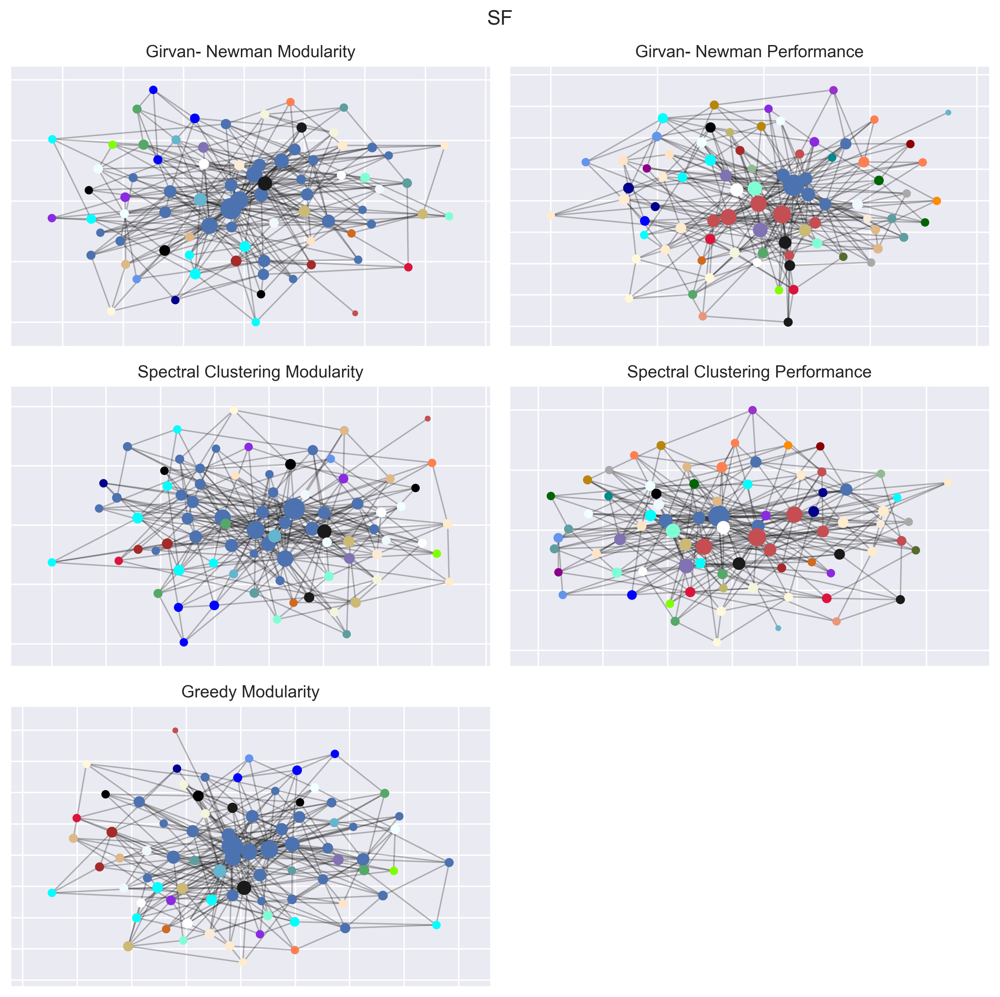

In [115]:
visualize_multiple('SF', 'SF')

<font color='blue'>σχολιασμός:</font> Για τα SF παρατηρούμε πως το modularity είναι χαμηλό για όλες τις μεθόδους, με μέγιστη τιμή 0.27 που την λαμβάνει με την συνάρτηση greedy modularity. Στην μετρική performance υπάρχει διακύμανση απο 0.84 και 0.91 στην συνάρτηση girvan neuman σε max modularity και max performance και 0.56 και 0.93 αντίστοιχα για την spectral clustering. Η greedy modularity δίνει performance 0.79. Ως προς τις κοινότητες ο girvan newman παράγει 30 και 43 κοινότηες, o spectral clustering 3 και 47 κοινότητες ενώ ο greedy modularity δίνει 5. Στα SF γραφήματα περιμένουμε κοινότητες γύρω από τους κόμβους μεγάλου βαθμού και σχετικά εύκολη διάκριση μεταξύ τους.